In [ ]:
%pip install scikit-learn --user

## Modelos Lineales

In [8]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

## Regresión Lineal

In [58]:
from sklearn.linear_model import LinearRegression

In [124]:
wm_df = pd.read_csv("walmart_ds/Walmart_Sales.csv")
wm_df

,Store,Date,Weekly_Sales,Holiday_Flag,Temperature,Fuel_Price,CPI,Unemployment
0,1,05-02-2010,1643690.90,0,42.31,2.572,211.096358,8.106
1,1,12-02-2010,1641957.44,1,38.51,2.548,211.242170,8.106
2,1,19-02-2010,1611968.17,0,39.93,2.514,211.289143,8.106
3,1,26-02-2010,1409727.59,0,46.63,2.561,211.319643,8.106
4,1,05-03-2010,1554806.68,0,46.50,2.625,211.350143,8.106
...,...,...,...,...,...,...,...,...
6430,45,28-09-2012,713173.95,0,64.88,3.997,192.013558,8.684
6431,45,05-10-2012,733455.07,0,64.89,3.985,192.170412,8.667
6432,45,12-10-2012,734464.36,0,54.47,4.000,192.327265,8.667
6433,45,19-10-2012,718125.53,0,56.47,3.969,192.330854,8.667


In [127]:
wm_df["Date"] = pd.to_datetime(wm_df["Date"], format="%d-%m-%Y")
wm_df["Date"] = pd.to_numeric(wm_df["Date"])

In [128]:
wm_df["Date"]

0       1265328000000000000
1       1265932800000000000
2       1266537600000000000
3       1267142400000000000
4       1267747200000000000
               ...         
6430    1348790400000000000
6431    1349395200000000000
6432    1350000000000000000
6433    1350604800000000000
6434    1351209600000000000
Name: Date, Length: 6435, dtype: int64

In [129]:
ndf = wm_df[["Store", "Date", "Weekly_Sales", "Holiday_Flag", "CPI"]]
ndf.head()

,Store,Date,Weekly_Sales,Holiday_Flag,CPI
0,1,1265328000000000000,1643690.90,0,211.096358
1,1,1265932800000000000,1641957.44,1,211.242170
2,1,1266537600000000000,1611968.17,0,211.289143
3,1,1267142400000000000,1409727.59,0,211.319643
4,1,1267747200000000000,1554806.68,0,211.350143


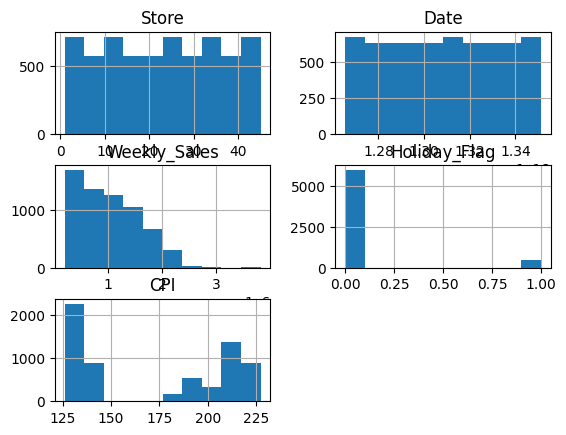

In [130]:
ndf.hist()
plt.show()

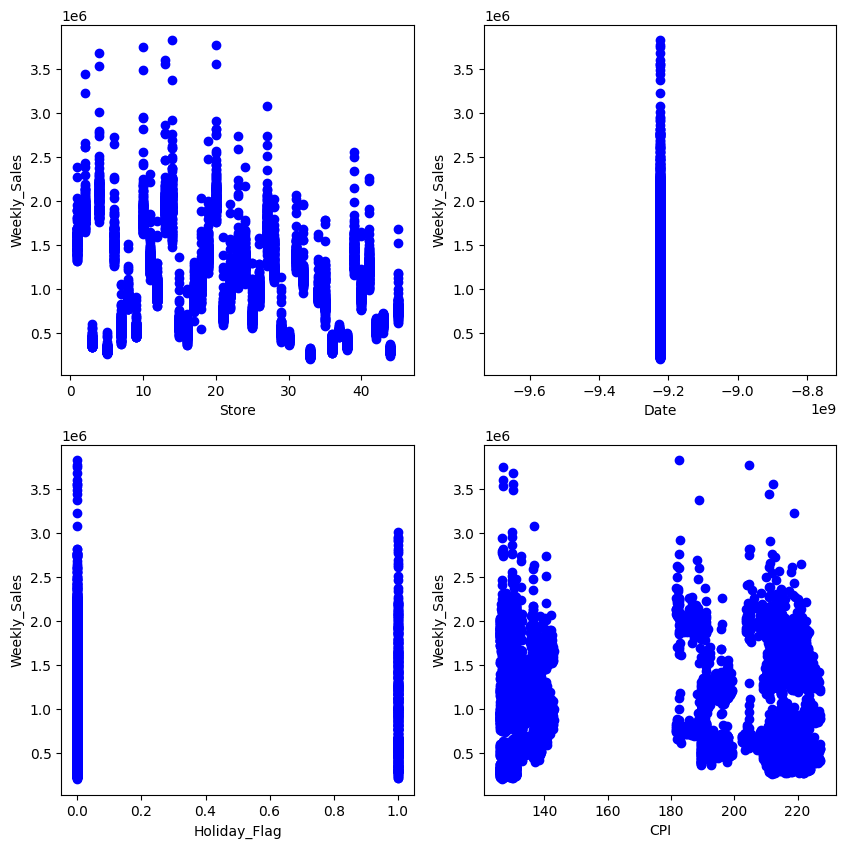

In [63]:
fig, axs = plt.subplots(2, 2, figsize=(10, 10))

for i, e in enumerate(ndf[["Store", "Date", "Holiday_Flag", "CPI"]]):
    axs[i // 2, i % 2].scatter(ndf[e], ndf["Weekly_Sales"], color="blue")
    axs[i // 2, i % 2].set_xlabel(e)
    axs[i // 2, i % 2].set_ylabel("Weekly_Sales")

Text(0.5, 1.0, 'Distribution of Weekly Sales')

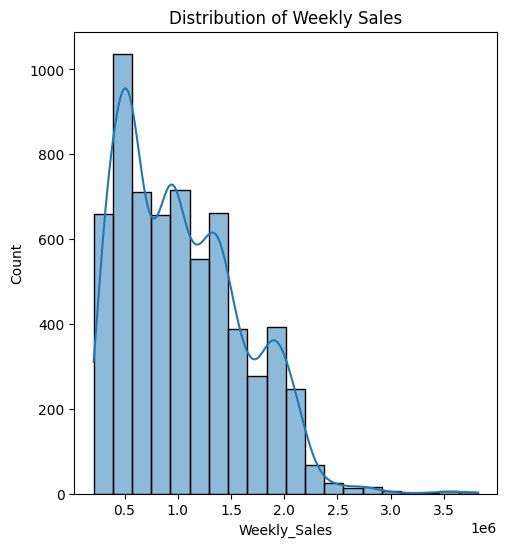

In [64]:
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
sns.histplot(ndf["Weekly_Sales"], bins=20, kde=True)
plt.title("Distribution of Weekly Sales")

### Train Test Split

In [158]:
X = wm_df[["Date", "Store", "Fuel_Price", "CPI"]]  # Features
y = wm_df["Weekly_Sales"]

print(X.shape)

from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.2, random_state=42
)

X_train.shape, X_test.shape, y_train.shape, y_test.shape

(6435, 4)


((5148, 4), (1287, 4), (5148,), (1287,))

### Linear Regression Model

In [159]:
lr_model = LinearRegression()
lr_model.fit(X_train, y_train)
y_pred = lr_model.predict(X_test)

### Evaluación

In [160]:
# MSE
from sklearn.metrics import mean_squared_error

mse = mean_squared_error(y_test, y_pred)
mse

275556098610.2112

In [161]:
y_test.shape, y_pred.shape

((1287,), (1287,))

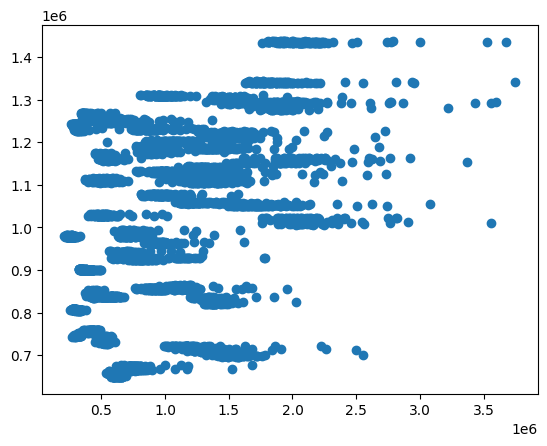

In [162]:
plt.scatter(y_train, lr_model.predict(X_train))

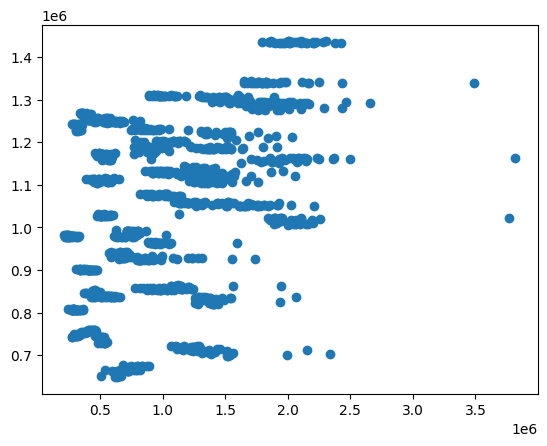

In [165]:
plt.scatter(y_test, y_pred)
# plt.plot([0, 1000000], [0, 1000000], "--k")

In [72]:
print("Coefficients:", lr_model.coef_)
print("Intercept:", lr_model.intercept_)

Coefficients: [     0.         -15707.73626386  -5038.60137214  -2077.47983658]
Intercept: 1781601.1174337883


## Regresión Logistica

In [144]:
from sklearn.datasets import load_breast_cancer

data_cancer = load_breast_cancer()

X_df = pd.DataFrame(data_cancer.data, columns=data_cancer.feature_names)
y_df = pd.DataFrame(data_cancer.target, columns=["target"])

cancer_ds = pd.concat([X_df, y_df], axis=1)
cancer_ds

,mean radius,mean texture,mean perimeter,mean area,mean smoothness,mean compactness,mean concavity,mean concave points,mean symmetry,mean fractal dimension,...,worst texture,worst perimeter,worst area,worst smoothness,worst compactness,worst concavity,worst concave points,worst symmetry,worst fractal dimension,target
0,17.99,10.38,122.80,1001.0,0.11840,0.27760,0.30010,0.14710,0.2419,0.07871,...,17.33,184.60,2019.0,0.16220,0.66560,0.7119,0.2654,0.4601,0.11890,0
1,20.57,17.77,132.90,1326.0,0.08474,0.07864,0.08690,0.07017,0.1812,0.05667,...,23.41,158.80,1956.0,0.12380,0.18660,0.2416,0.1860,0.2750,0.08902,0
2,19.69,21.25,130.00,1203.0,0.10960,0.15990,0.19740,0.12790,0.2069,0.05999,...,25.53,152.50,1709.0,0.14440,0.42450,0.4504,0.2430,0.3613,0.08758,0
3,11.42,20.38,77.58,386.1,0.14250,0.28390,0.24140,0.10520,0.2597,0.09744,...,26.50,98.87,567.7,0.20980,0.86630,0.6869,0.2575,0.6638,0.17300,0
4,20.29,14.34,135.10,1297.0,0.10030,0.13280,0.19800,0.10430,0.1809,0.05883,...,16.67,152.20,1575.0,0.13740,0.20500,0.4000,0.1625,0.2364,0.07678,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
564,21.56,22.39,142.00,1479.0,0.11100,0.11590,0.24390,0.13890,0.1726,0.05623,...,26.40,166.10,2027.0,0.14100,0.21130,0.4107,0.2216,0.2060,0.07115,0
565,20.13,28.25,131.20,1261.0,0.09780,0.10340,0.14400,0.09791,0.1752,0.05533,...,38.25,155.00,1731.0,0.11660,0.19220,0.3215,0.1628,0.2572,0.06637,0
566,16.60,28.08,108.30,858.1,0.08455,0.10230,0.09251,0.05302,0.1590,0.05648,...,34.12,126.70,1124.0,0.11390,0.30940,0.3403,0.1418,0.2218,0.07820,0
567,20.60,29.33,140.10,1265.0,0.11780,0.27700,0.35140,0.15200,0.2397,0.07016,...,39.42,184.60,1821.0,0.16500,0.86810,0.9387,0.2650,0.4087,0.12400,0


In [145]:
cancer_ds.columns

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension',
       'target'],
      dtype='object')

### Exploración de Datos (EDA)

Correlación entre variables.

Ojo: Correlación no implica causalidad (https://www.tylervigen.com/spurious/correlation/2488_robberies-in-maryland_correlates-with_us-birth-rates-of-triplets-or-more)

In [166]:
cancer_ds.columns

Index(['mean radius', 'mean texture', 'mean perimeter', 'mean area',
       'mean smoothness', 'mean compactness', 'mean concavity',
       'mean concave points', 'mean symmetry', 'mean fractal dimension',
       'radius error', 'texture error', 'perimeter error', 'area error',
       'smoothness error', 'compactness error', 'concavity error',
       'concave points error', 'symmetry error', 'fractal dimension error',
       'worst radius', 'worst texture', 'worst perimeter', 'worst area',
       'worst smoothness', 'worst compactness', 'worst concavity',
       'worst concave points', 'worst symmetry', 'worst fractal dimension',
       'target'],
      dtype='object')

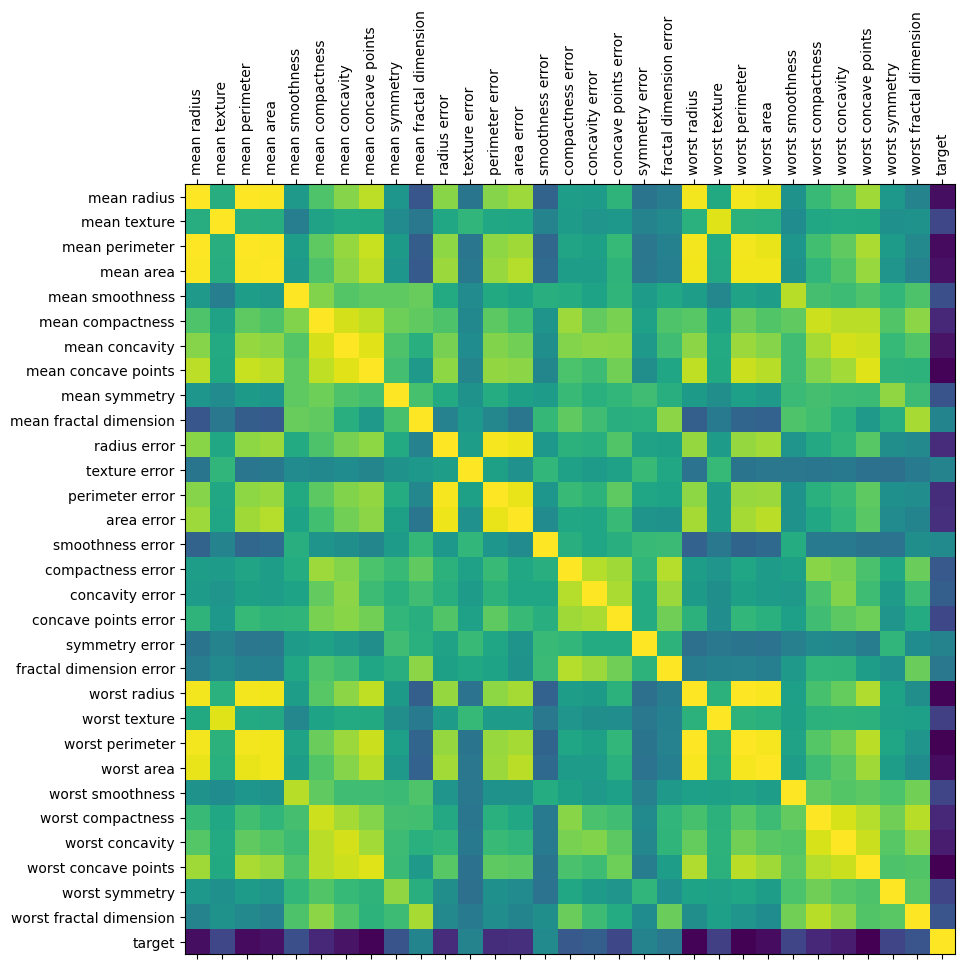

In [16]:
# Correlation Matrix

cm = cancer_ds.corr()

fig, ax = plt.subplots(figsize=(10, 10))
ax.matshow(cm)
plt.xticks(range(len(cm.columns)), cm.columns)
plt.xticks(rotation=90)
plt.yticks(range(len(cm.columns)), cm.columns)

plt.show()

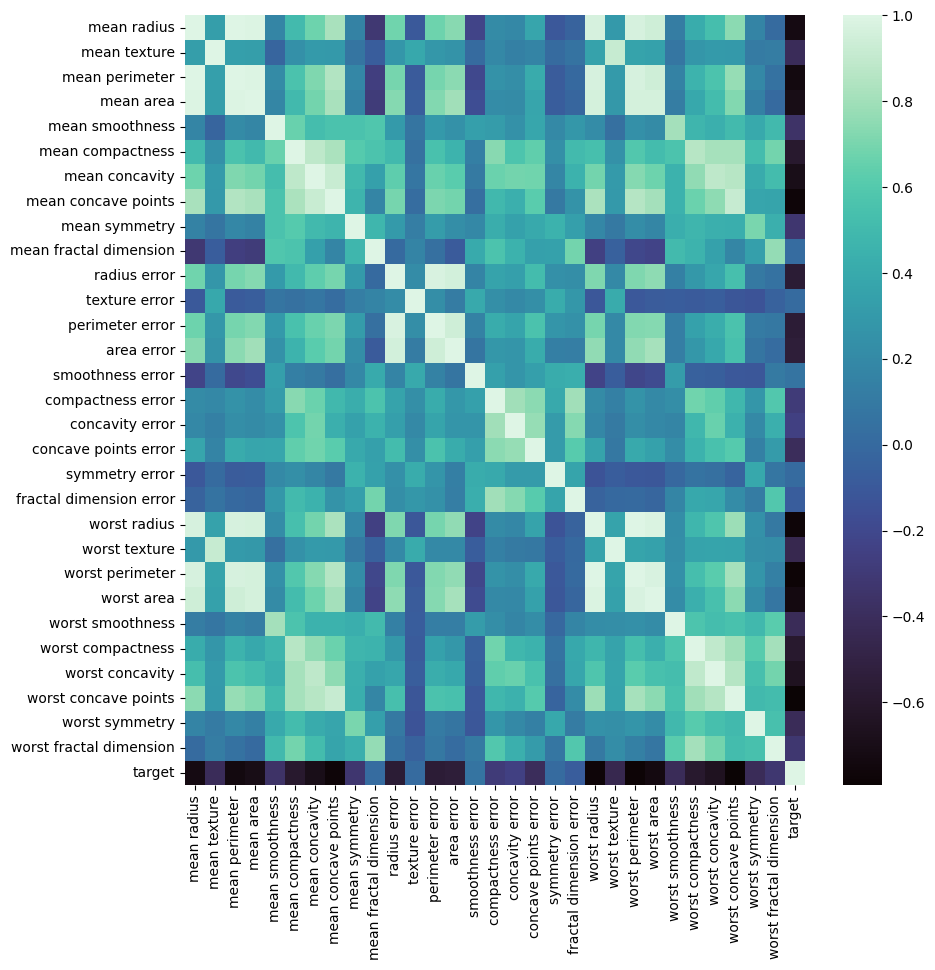

In [21]:
# Correlation Matrix using Seaborn

fig, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(cm, ax=ax, cmap="mako")
plt.show()

In [146]:
cancer_ds["target"].value_counts()

target
1    357
0    212
Name: count, dtype: int64

<Axes: xlabel='target', ylabel='Count'>

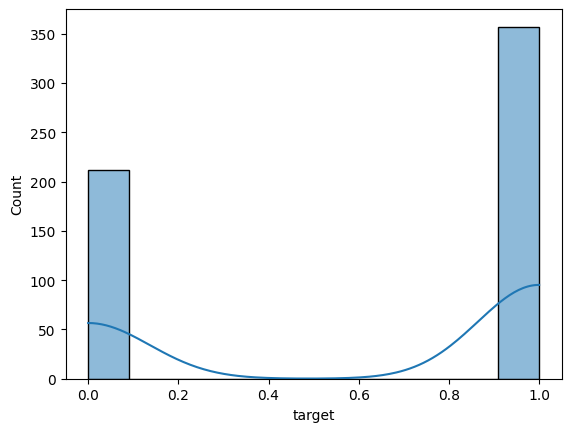

In [24]:
sns.histplot(cancer_ds["target"], kde=True)

<Axes: xlabel='worst radius', ylabel='Count'>

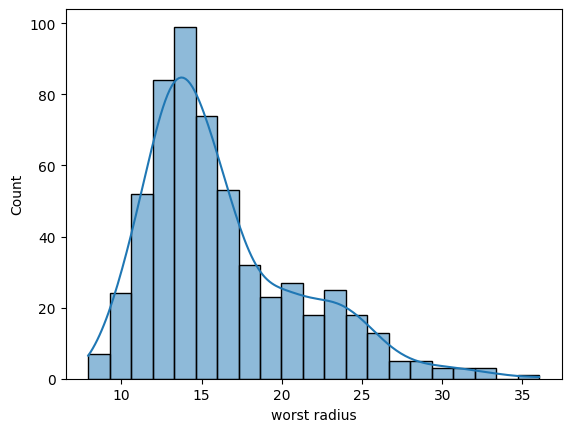

In [26]:
sns.histplot(cancer_ds["worst radius"], kde=True)

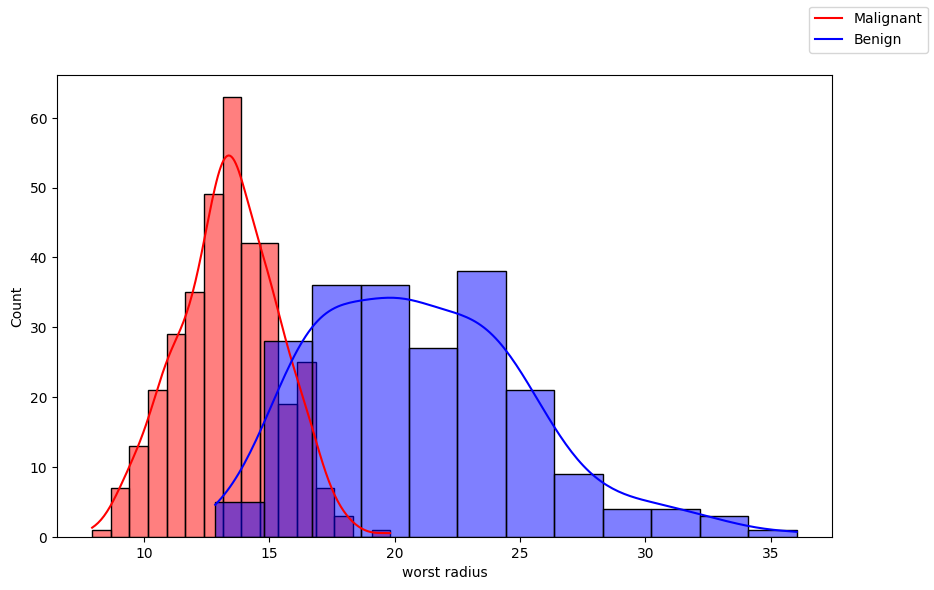

In [36]:
ds_true = cancer_ds[cancer_ds["target"] == 1]
ds_false = cancer_ds[cancer_ds["target"] == 0]

fig, ax = plt.subplots(figsize=(10, 6))

sns.histplot(ds_true["worst radius"], kde=True, color="red", ax=ax)
sns.histplot(ds_false["worst radius"], kde=True, color="blue", ax=ax)

fig.legend(labels=["Malignant", "Benign"])

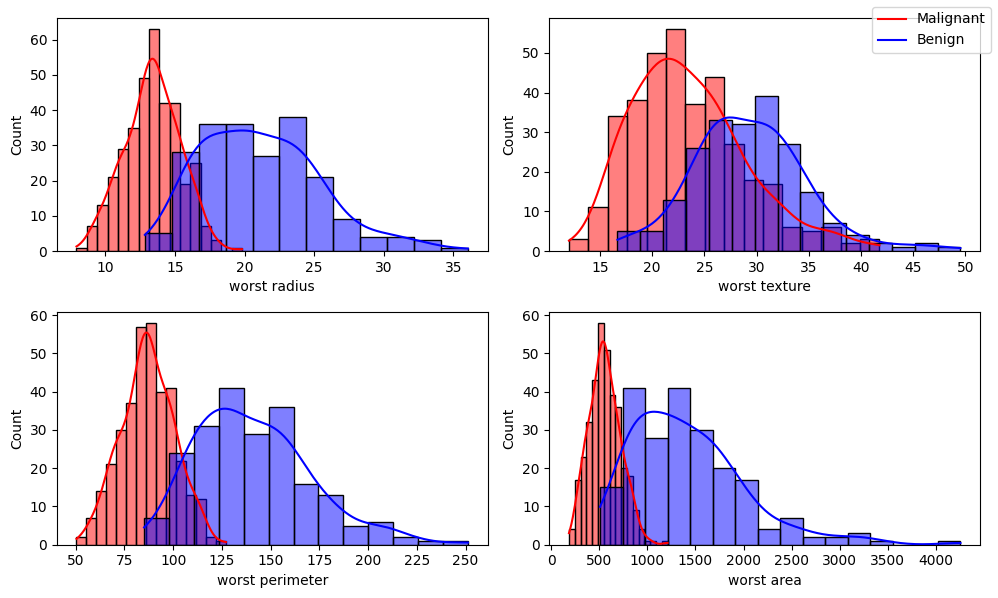

In [37]:
ds_true = cancer_ds[cancer_ds["target"] == 1]
ds_false = cancer_ds[cancer_ds["target"] == 0]

fig, axs = plt.subplots(2, 2, figsize=(10, 6))

sns.histplot(ds_true["worst radius"], kde=True, color="red", ax=axs[0, 0])
sns.histplot(ds_false["worst radius"], kde=True, color="blue", ax=axs[0, 0])

sns.histplot(ds_true["worst texture"], kde=True, color="red", ax=axs[0, 1])
sns.histplot(ds_false["worst texture"], kde=True, color="blue", ax=axs[0, 1])

sns.histplot(ds_true["worst perimeter"], kde=True, color="red", ax=axs[1, 0])
sns.histplot(ds_false["worst perimeter"], kde=True, color="blue", ax=axs[1, 0])

sns.histplot(ds_true["worst area"], kde=True, color="red", ax=axs[1, 1])
sns.histplot(ds_false["worst area"], kde=True, color="blue", ax=axs[1, 1])

fig.legend(labels=["Malignant", "Benign"])

fig.tight_layout()

In [38]:
# sns pairplot

sns.pairplot(cancer_ds, hue="target")

### Train Test Split

In [147]:
seed = 42

X_train, X_test, y_train, y_test = train_test_split(X_df, y_df, test_size=0.2, random_state=seed)

### Modelo de Regresión Logística

In [148]:
from sklearn.linear_model import LogisticRegression

log_model = LogisticRegression()
log_model.fit(X_train, y_train.values.ravel())

/Users/nacho/.local/lib/python3.8/site-packages/sklearn/linear_model/_logistic.py:460: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression()

In [149]:
y_pred = log_model.predict(X_test)

Accuracy: 0.9649122807017544


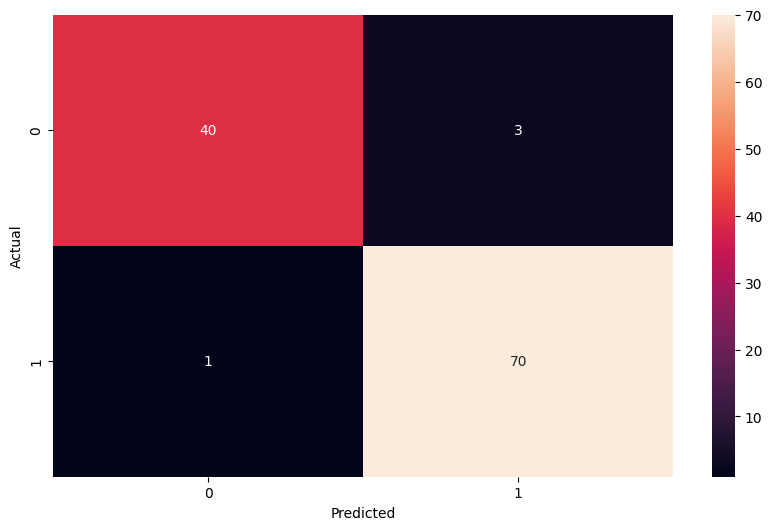

In [150]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import confusion_matrix

accuracy = accuracy_score(y_test, y_pred)
print("Accuracy:", accuracy)

cm = confusion_matrix(y_test, y_pred)

fig, ax = plt.subplots(figsize=(10, 6))
sns.heatmap(cm, annot=True, ax=ax)
_ = plt.xlabel("Predicted")
_ = plt.ylabel("Actual")

In [151]:
from sklearn.metrics import classification_report

print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

           0       0.98      0.93      0.95        43
           1       0.96      0.99      0.97        71

    accuracy                           0.96       114
   macro avg       0.97      0.96      0.96       114
weighted avg       0.97      0.96      0.96       114



### With Preprocessing

Accuracy: 0.9736842105263158


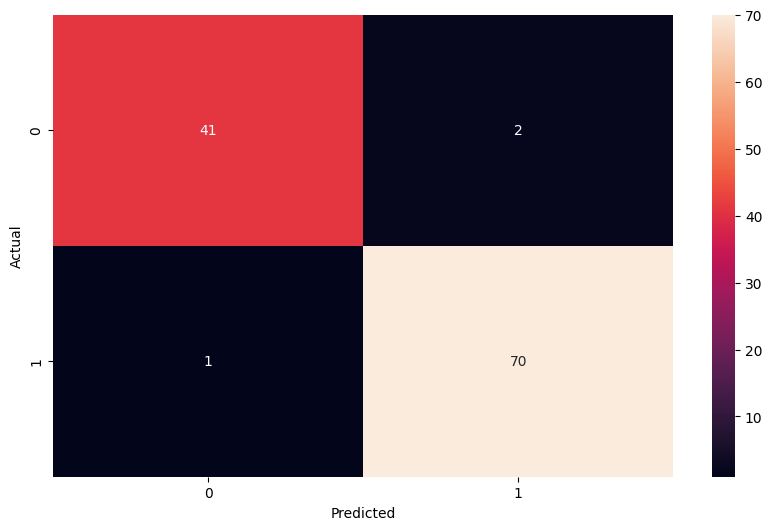

In [154]:
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler

pipe = Pipeline([
    ("scaler", StandardScaler()), 
    ("logistic", LogisticRegression())
])

pipe.fit(X_train, y_train.values.ravel())

y_pred_scale = pipe.predict(X_test)

accuracy = accuracy_score(y_test, y_pred_scale)
cm = confusion_matrix(y_test, y_pred_scale)

print("Accuracy:", accuracy)

fig, ax = plt.subplots(figsize=(10, 6))
sns.heatmap(cm, annot=True, ax=ax)
_ = plt.xlabel("Predicted")
_ = plt.ylabel("Actual")


### Comparación Coeficientes

### Sin Escalado

In [97]:
print("Coefficients:", log_model.coef_)
print("Intercept:", log_model.intercept_)

Coefficients: [[ 1.46304058  0.14871667  0.18890307 -0.00800056 -0.05557044 -0.26489761
  -0.36702132 -0.15783407 -0.08323764 -0.01667472  0.04615938  0.69844162
   0.02615261 -0.09674665 -0.00531719 -0.05281071 -0.0736259  -0.02025498
  -0.01976343 -0.00455609  1.51518142 -0.3935534  -0.25530984 -0.02457533
  -0.09888376 -0.79797502 -0.98676232 -0.29097617 -0.27145013 -0.07419554]]
Intercept: [0.28248392]


<BarContainer object of 30 artists>

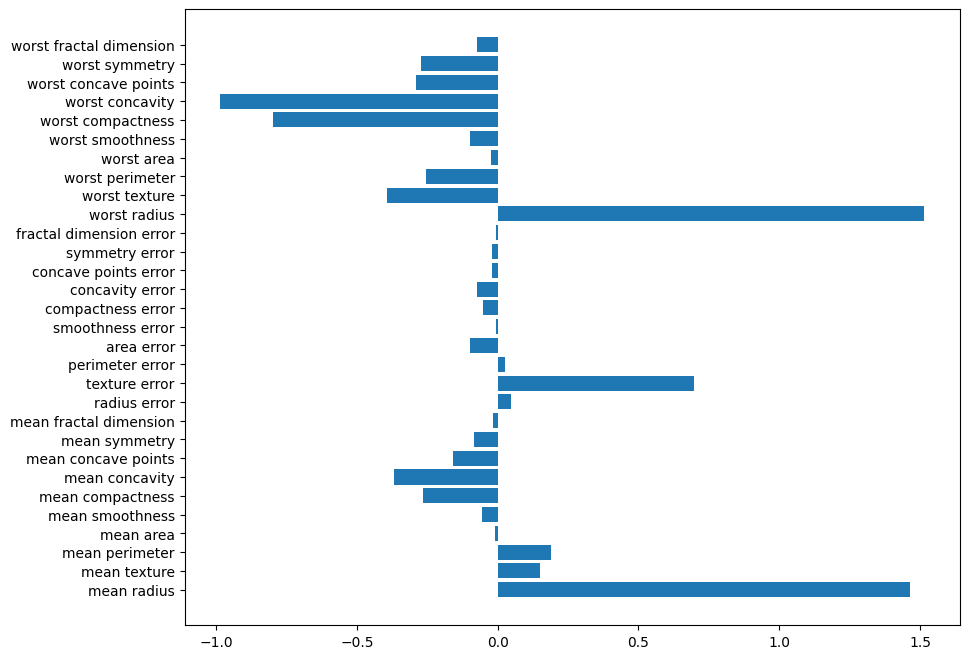

In [103]:
# Plot

fig, ax = plt.subplots(figsize=(10, 8))

ax.barh(X_df.columns, log_model.coef_[0])

<BarContainer object of 30 artists>

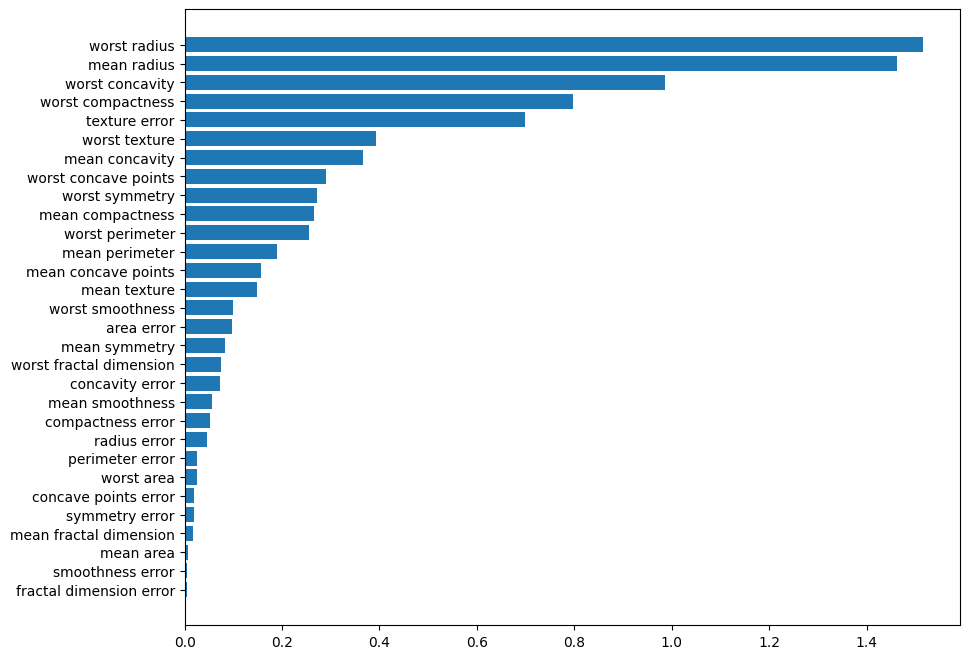

In [112]:
import numpy as np

fig, ax = plt.subplots(figsize=(10, 8))

feature_importances = pd.DataFrame(
    {"column": X_df.columns, "coef": np.abs(log_model.coef_[0])}
).sort_values(by="coef", ascending=True)

ax.barh(feature_importances["column"], feature_importances["coef"])

#### Con Escalado

In [98]:
print("Coefficients:", pipe.named_steps["logistic"].coef_)
print("Intercept:", pipe.named_steps["logistic"].intercept_)

Coefficients: [[-0.42789615 -0.39391343 -0.38955025 -0.46431618 -0.06675416  0.54210625
  -0.79677127 -1.1170207   0.23571257  0.07670117 -1.27114722  0.18863977
  -0.60936581 -0.90979979 -0.31246106  0.68597229  0.18081531 -0.31769168
   0.49997976  0.61340541 -0.87861043 -1.3421883  -0.58755707 -0.84655924
  -0.54994459  0.00520705 -0.94571375 -0.77343621 -1.20853126 -0.1541604 ]]
Intercept: [0.44359695]


<BarContainer object of 30 artists>

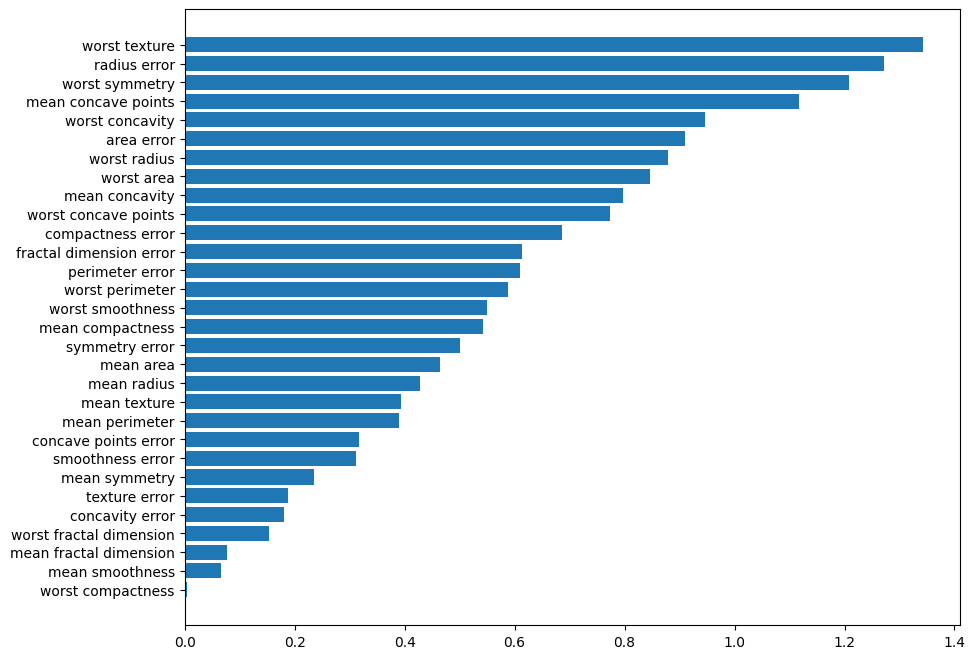

In [114]:
import numpy as np

fig, ax = plt.subplots(figsize=(10, 8))

feature_importances = pd.DataFrame(
    {"column": X_df.columns, "coef": np.abs(pipe.named_steps["logistic"].coef_[0])}
).sort_values(by="coef", ascending=True)

ax.barh(feature_importances["column"], feature_importances["coef"])